Let's try to sharpen the images or look at the surrounding area of each pixel to highlight areas that may have an issue. Then let's look at
trying to quantify the noise in each image.

In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pathlib
from sklearn import preprocessing, cluster, metrics


paths = pathlib.Path('./OT data 80 um/int').glob('*.tif')
paths_sorted = [x for x in paths]
paths_sorted.sort()

powderthickness = 80
objectinfo = pd.read_csv('Parameters.csv', names=["Object", "P", "S", "H", "Porosity"])
objectinfo.insert(1, "VED", objectinfo.P * 1000/(objectinfo.S * objectinfo.H * powderthickness))
ims = np.array([np.array(plt.imread(path)) for path in paths_sorted])

# Don't touch original
integrals = np.copy(ims)

In [20]:
objectwidth = 83
objectheight = 122
xspacing = 133
yspacing = 270
xstart = 293
ystart = 268
xend = 1730
yend = 1770
objectCoordinates = [[x, x+objectwidth, y, y+objectheight] for y in reversed(range(
    ystart, yend, objectheight + yspacing)) for x in range(xstart, xend, xspacing + objectwidth)]
coorddf = pd.DataFrame(objectCoordinates, columns=['xstart', 'xend', 'ystart', 'yend'])
objectinfo = coorddf.join(objectinfo)


/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_32724/1426580488.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12,5))


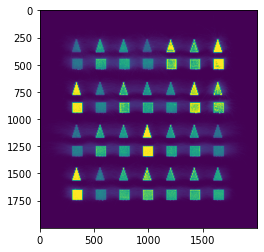

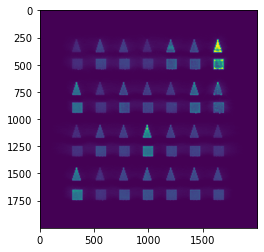

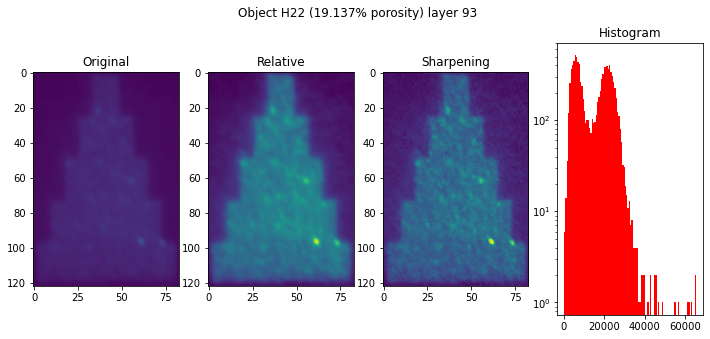

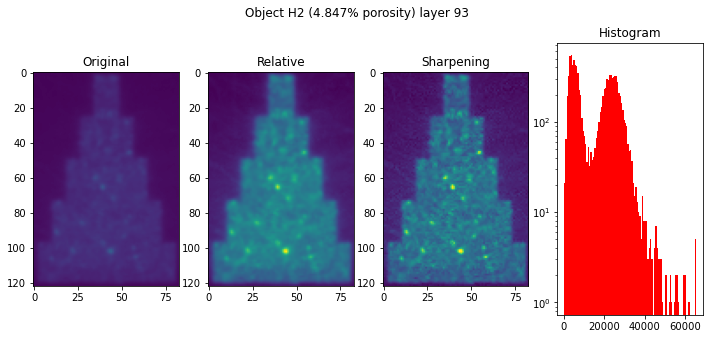

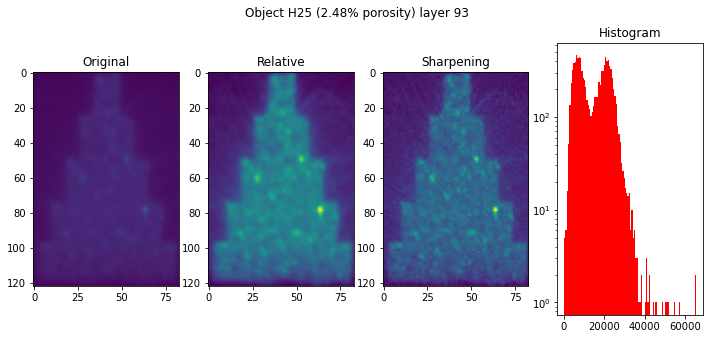

...

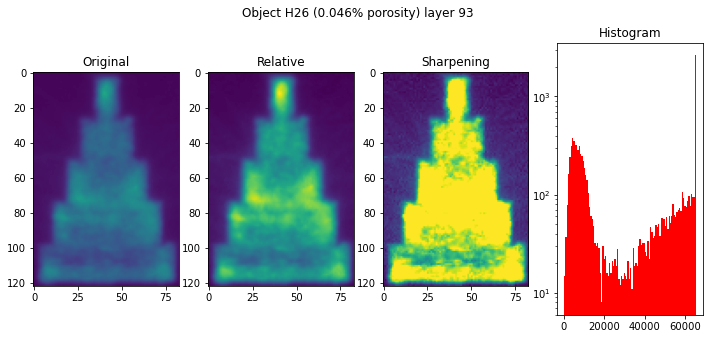

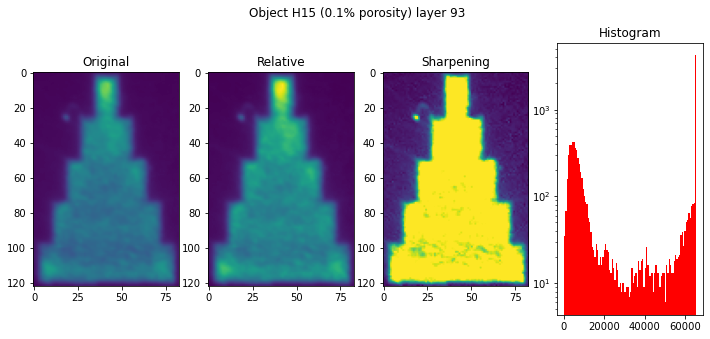

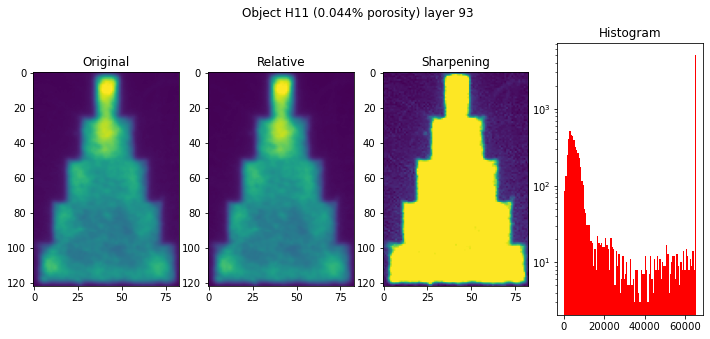

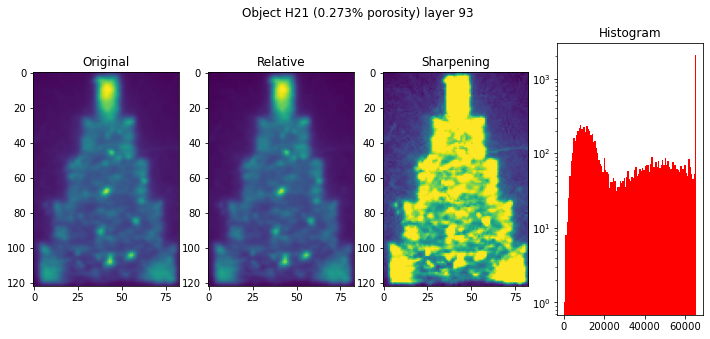

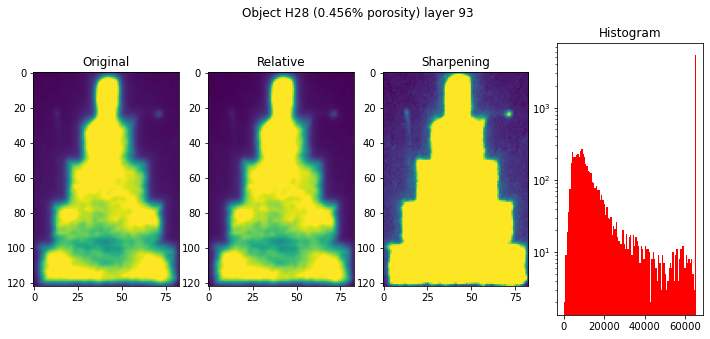

In [51]:
import cv2
# How do we implement the sharpening?
# A simple approach would be to do 2d convolution across the integrals
# A more ambitious approach would be to

# image = integrals[93] // 2
image = integrals[93]

# kernel = np.array([[0, -3, 0],
#                    [-3, 15, -3],
#                    [0, -3, 0]])
# kernel2 = np.array([[0, -1, 0],
#                    [-1, 5, -1],
#                    [0, -1, 0]])
# kernel3 = np.array([[0, -2, 0],
#                    [-2, 10, -2],
#                    [0, -2, 0]])
# image_sharp = cv2.filter2D(src=image, ddepth=-1, kernel=kernel)
# image_sharp2 = cv2.filter2D(src=image, ddepth=-1, kernel=kernel2)
# image_sharp3 = cv2.filter2D(src=image, ddepth=-1, kernel=kernel3)
sharpeningRange = range(1, 6)
kernels = [
    np.array([  [0, -i, 0],
                [-i, i*5, -i],
                [0, -i, 0]])
    for i in sharpeningRange]
sharp_images = [cv2.filter2D(src=image, ddepth=-1, kernel=kernel) for kernel in kernels]
plt.imshow(image_sharp)
plt.figure()
plt.imshow(integrals[93])

# Let's look at individual objects
imageNo = 93
# objectNo = 2
# object = objectinfo.iloc[objectNo -1]
max_sharp = np.max(image_sharp)
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12,5))
    ax1.set_title("Original")
    ax2.set_title("Relative")
    ax3.set_title("Sharpening")
    ax4.set_title("Histogram")
    fig.suptitle("Object " + object.Object + " (" +
                    str(object.Porosity) + "% porosity) layer " + str(imageNo))
    ax1.imshow(integrals[imageNo, object.ystart:object.yend,
                object.xstart:object.xend], vmin=0, vmax=65535)
    ax2.imshow(integrals[imageNo, object.ystart:object.yend,
                object.xstart:object.xend])
    ax3.imshow(image_sharp[object.ystart:object.yend,
                        object.xstart:object.xend])
    ax4.hist(image_sharp[object.ystart:object.yend,object.xstart:object.xend].flatten(), bins=100, color='r', range=(0,65535))
    ax4.set_yscale('log')

Wow, that really looks promising. The more yellow an object is, the lower the porosity? Let's plot the relationship.

Funderar om vi återuppfunnit hjulet... Hur presterar OT summa?

/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_32724/336270051.py:17: RuntimeWarning: overflow encountered in ulong_scalars
  x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])


Text(0.5, 0, 'VED')

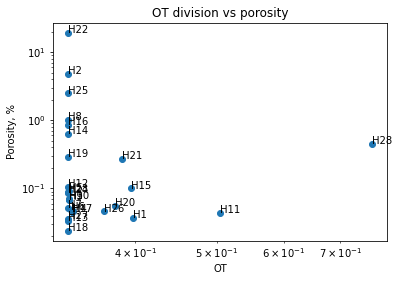

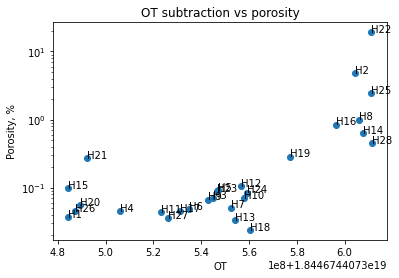

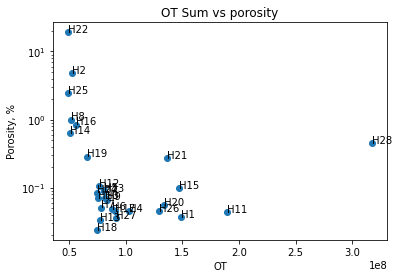

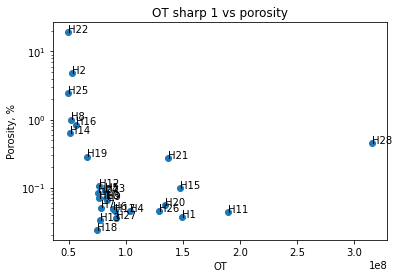

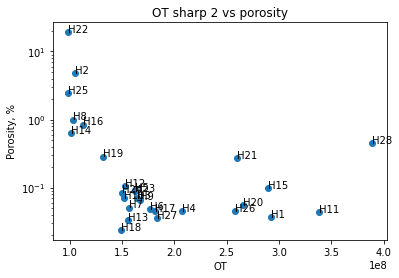

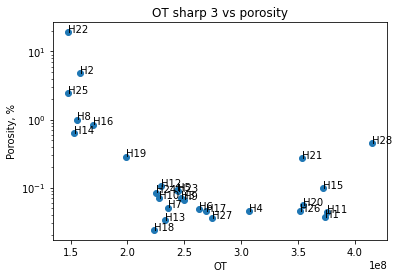

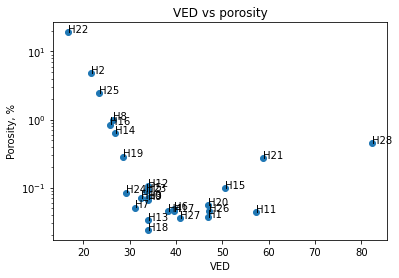

In [56]:
y = objectinfo.Porosity

plt.title("OT division vs porosity")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     / np.sum(image_sharp[object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.xscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

plt.title("OT subtraction vs porosity")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     - np.sum(image_sharp[object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

# Todo: compare relative as well

plt.title("OT Sum vs porosity")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

plt.title("OT sharp 1 vs porosity")
x = [np.sum(image_sharp2[object.ystart:object.yend, object.xstart:object.xend]) for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

plt.title("OT sharp 2 vs porosity")
x = [np.sum(image_sharp3[object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

plt.title("OT sharp 3 vs porosity")
x = [np.sum(image_sharp[object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

plt.title("VED vs porosity")
x = objectinfo.VED
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('VED')

# Om man drar en gräns, hur ser det ut?
# Spontant, plotta med olika värden?
# Föremål 


It looks like it still doesn't beat OT and still has the same issue (i.e. it being an arbitrary number). Let's increase the sharpening effect and see what happens

/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_32724/2348801805.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))


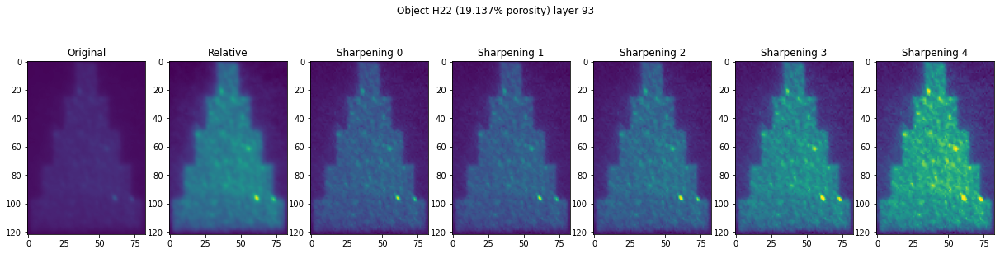

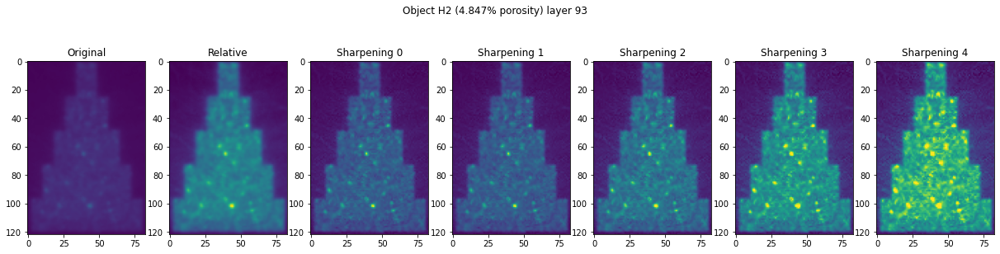

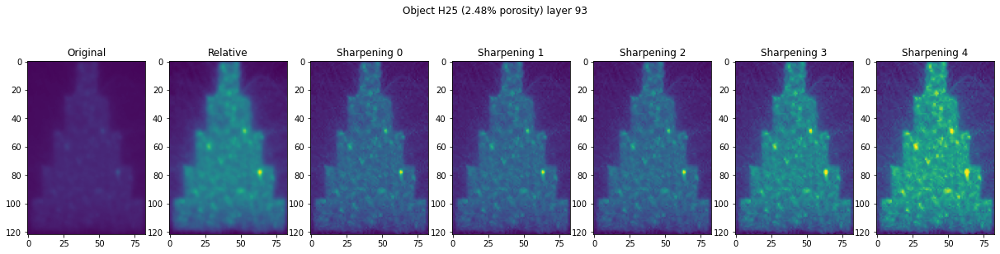

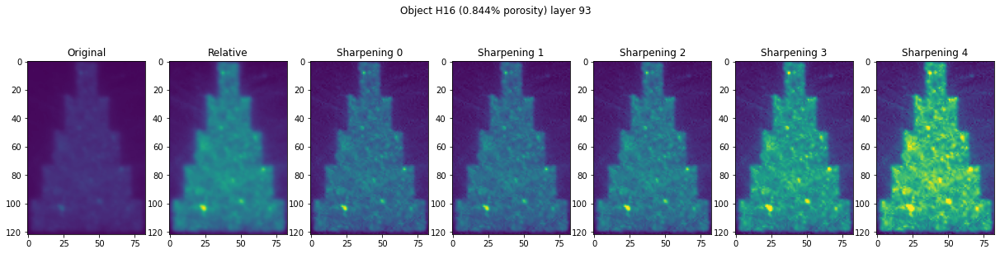

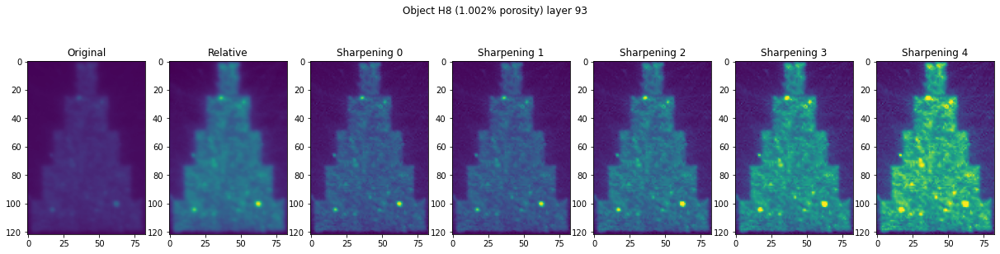

...

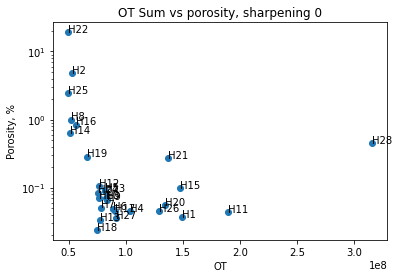

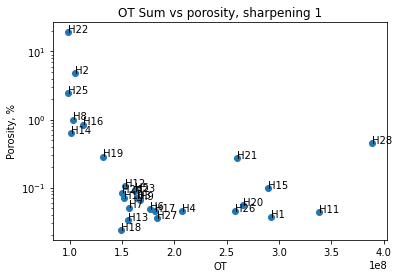

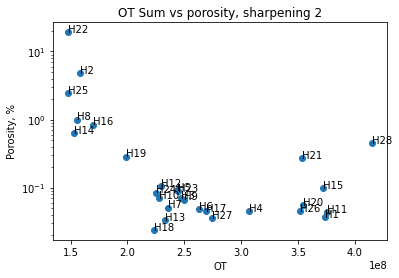

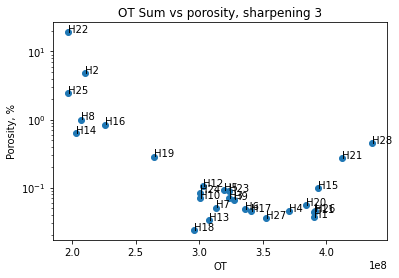

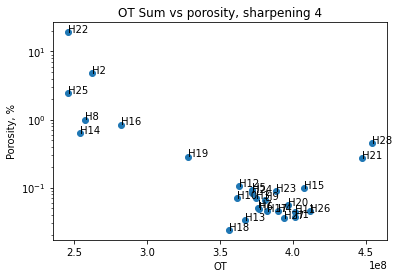

<Figure size 432x288 with 0 Axes>

In [78]:
image = integrals[93]
sharpeningRange = range(1, 6)
kernels = [
    np.array([[0, -i, 0],
              [-i, i*5, -i],
              [0, -i, 0]])
    for i in sharpeningRange]
sharp_images = [cv2.filter2D(src=image, ddepth=-1, kernel=kernel)
                for kernel in kernels]

# Let's look at individual objects
imageNo = 93
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    noOfImages = len(sharp_images)
    plots = noOfImages + 2
    fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))
    fig.suptitle("Object " + object.Object + " (" +
                 str(object.Porosity) + "% porosity) layer " + str(imageNo))
    axs[0].set_title("Original")
    axs[1].set_title("Relative")
    axs[0].imshow(integrals[imageNo, object.ystart:object.yend,
                         object.xstart:object.xend], vmin=0, vmax=65535)
    axs[1].imshow(integrals[imageNo, object.ystart:object.yend,
                         object.xstart:object.xend])
    for index,img in enumerate(sharp_images):
        o = index+2
        axs[o].imshow(img[object.ystart:object.yend,
                            object.xstart:object.xend])
        axs[o].set_title("Sharpening " + str(index))

# Scatter plots
plt.figure()
y = objectinfo.Porosity
plt.title("OT Sum vs porosity original")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

for index, image in enumerate(sharp_images):
    plt.title("OT Sum vs porosity, sharpening " + str(index))
    x = [np.sum(image[object.ystart:object.yend, object.xstart:object.xend])
         for index, object in objectinfo.iterrows()]
    plt.scatter(x, y)
    for index, row in objectinfo.iterrows():
        plt.annotate(text=row.Object, xy=(x[index], y[index]))
    plt.yscale('log')
    plt.ylabel('Porosity, %')
    plt.xlabel('OT')
    plt.figure()

This looks very promising, but the approach is fundamentally dependent on the signal saturating. The OT of overheated objects grow faster with increased sharpening as a consequence of the spatter. The OT of underheated objects grow slower with increased sharpening as a consequence of 
We need to fix two things:
1. Make it unitless
2. Adapt it to the maximum value found in the image. Else, the sensor will affect the method.
    Or will it? 

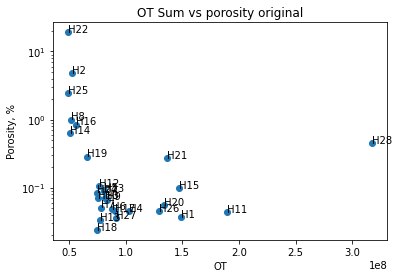

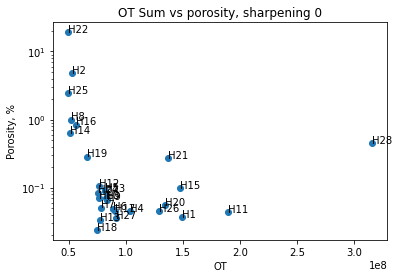

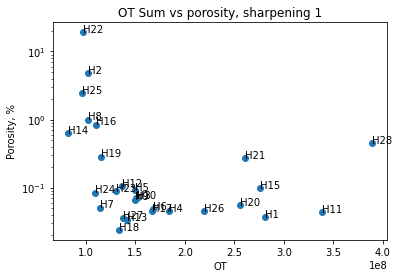

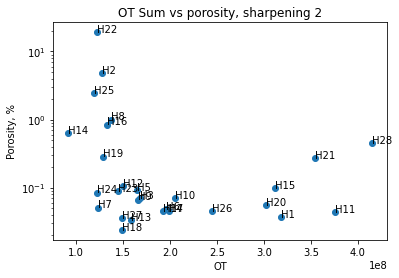

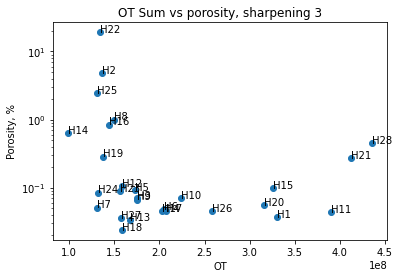

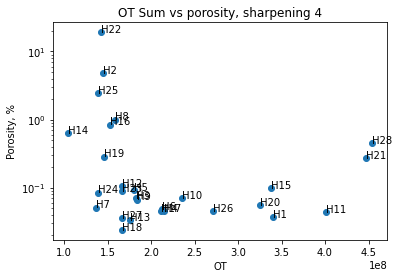

<Figure size 432x288 with 0 Axes>

In [79]:
y = objectinfo.Porosity
plt.title("OT Sum vs porosity original")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

for index, image in enumerate(sharp_images):
    plt.title("OT Sum vs porosity, sharpening " + str(index))
    x = []
    for i, object in objectinfo.iterrows():
        max_value = np.max(
            integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
        pixels = image[object.ystart:object.yend, object.xstart:object.xend]
        pixels[pixels > max_value] = max_value
        x.append(np.sum(pixels))
    plt.scatter(x, y)
    for index, row in objectinfo.iterrows():
        plt.annotate(text=row.Object, xy=(x[index], y[index]))
    plt.yscale('log')
    plt.ylabel('Porosity, %')
    plt.xlabel('OT')
    plt.figure()


Interesting. The sharpening filter still manages to filter out the KH instance. Need to look into what exactly is going on there.

At 23:00, start the presentation.

Let's try again with better settings.

/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_32724/85640125.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))


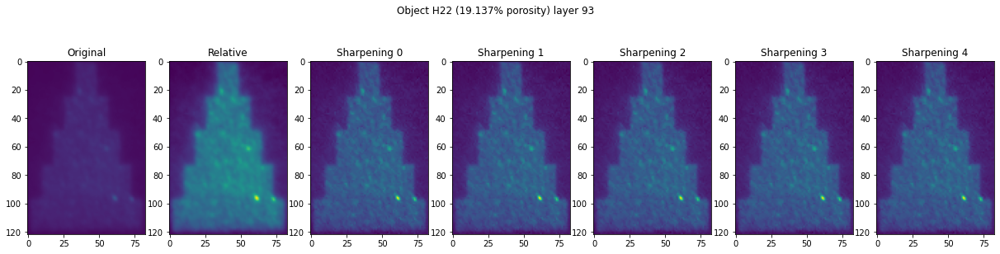

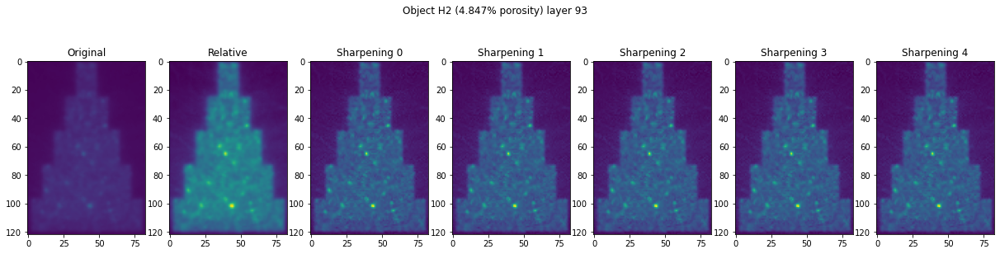

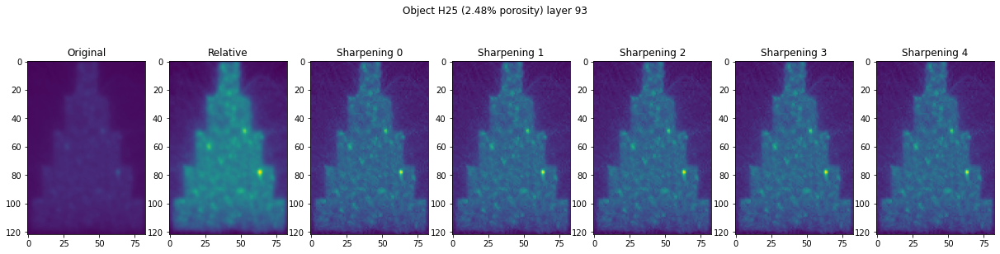

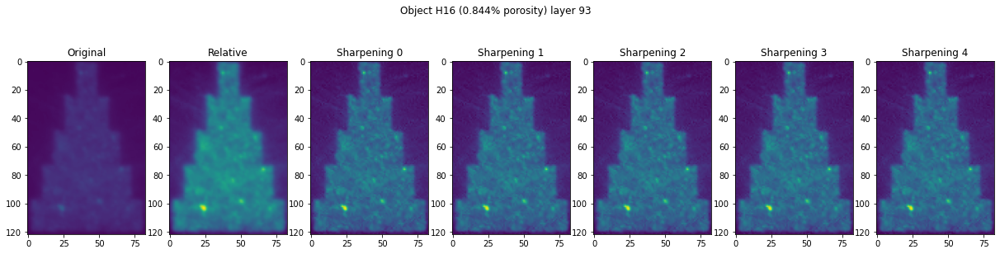

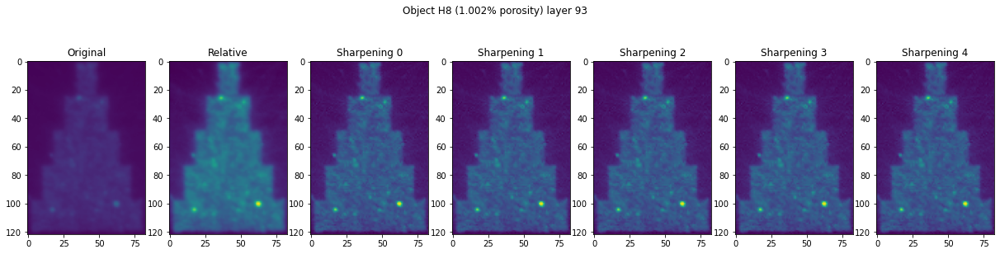

...

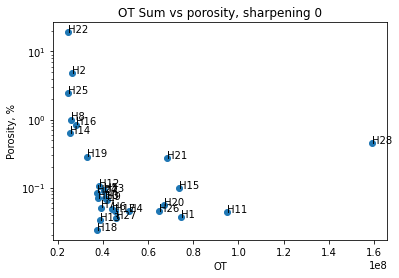

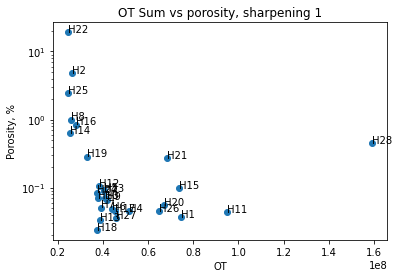

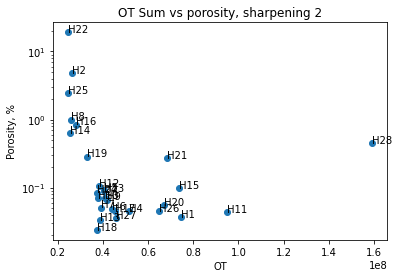

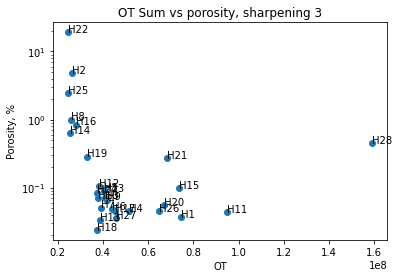

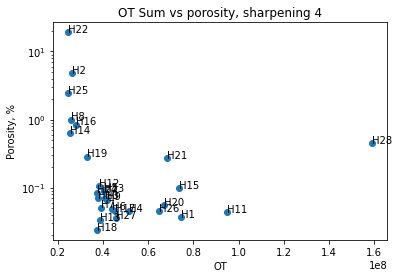

<Figure size 432x288 with 0 Axes>

In [80]:
image = integrals[93] // 2
sharpeningRange = range(1, 6)
kernels = [
    np.array([[0, -i, 0],
              [-i, i*5, -i],
              [0, -i, 0]])
    for i in sharpeningRange]
sharp_images = [cv2.filter2D(src=(image // (index+1)), ddepth=-1, kernel=kernel)
                for index, kernel in enumerate(kernels)]

# Let's look at individual objects
imageNo = 93
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    noOfImages = len(sharp_images)
    plots = noOfImages + 2
    fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))
    fig.suptitle("Object " + object.Object + " (" +
                 str(object.Porosity) + "% porosity) layer " + str(imageNo))
    axs[0].set_title("Original")
    axs[1].set_title("Relative")
    axs[0].imshow(integrals[imageNo, object.ystart:object.yend,
                            object.xstart:object.xend], vmin=0, vmax=65535)
    axs[1].imshow(integrals[imageNo, object.ystart:object.yend,
                            object.xstart:object.xend])
    for index, img in enumerate(sharp_images):
        o = index+2
        axs[o].imshow(img[object.ystart:object.yend,
                          object.xstart:object.xend])
        axs[o].set_title("Sharpening " + str(index))

# Scatter plots
plt.figure()
y = objectinfo.Porosity
plt.title("OT Sum vs porosity original")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

for index, image in enumerate(sharp_images):
    plt.title("OT Sum vs porosity, sharpening " + str(index))
    x = [np.sum(image[object.ystart:object.yend, object.xstart:object.xend])
         for index, object in objectinfo.iterrows()]
    plt.scatter(x, y)
    for index, row in objectinfo.iterrows():
        plt.annotate(text=row.Object, xy=(x[index], y[index]))
    plt.yscale('log')
    plt.ylabel('Porosity, %')
    plt.xlabel('OT')
    plt.figure()


Well that wasn't very fun. Let's try blurring instead

/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_32724/1886567569.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))


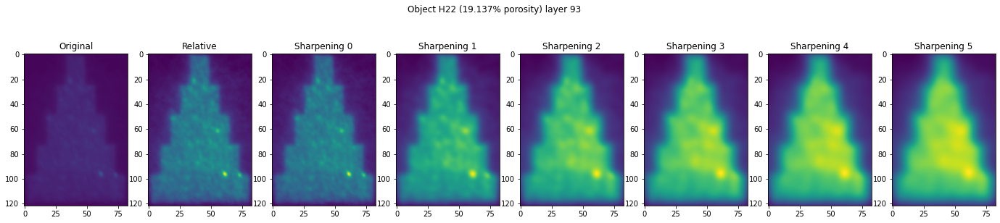

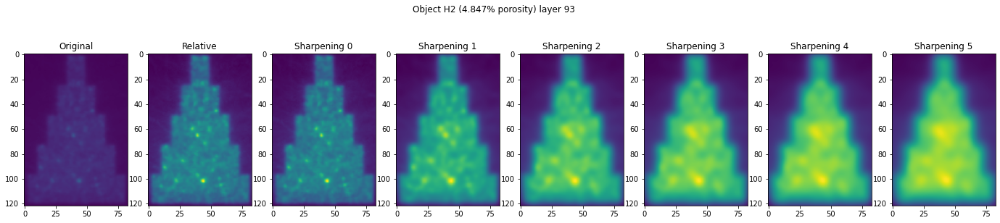

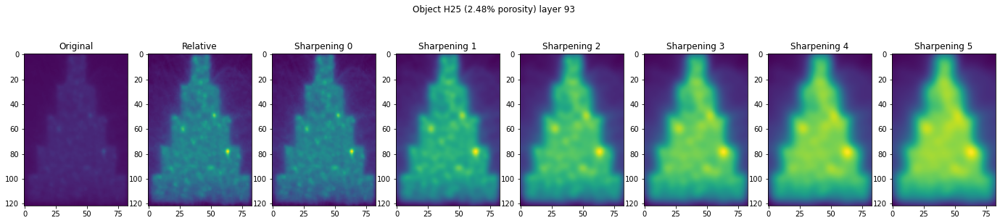

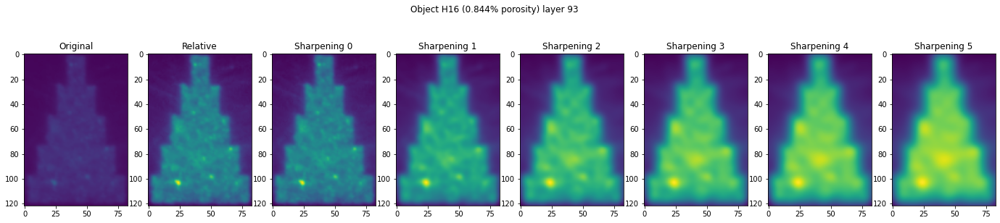

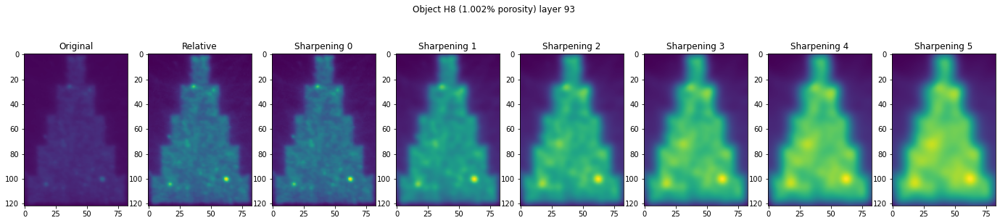

...

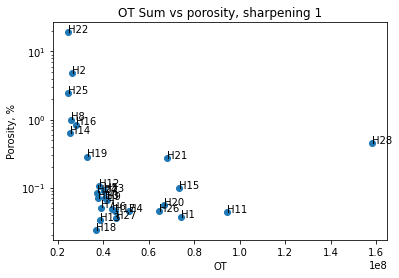

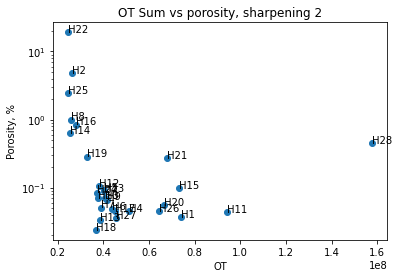

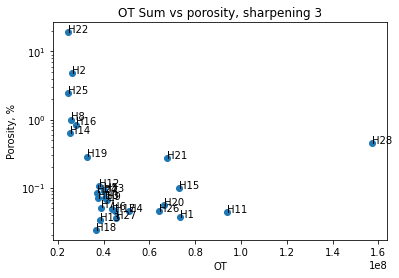

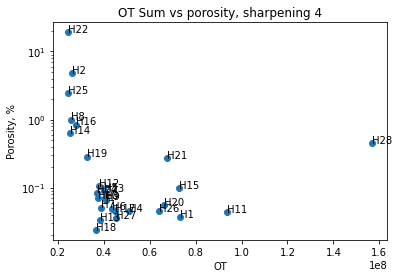

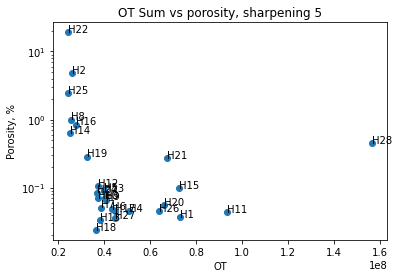

<Figure size 432x288 with 0 Axes>

In [83]:
image = integrals[93] // 2
sharpeningRange = range(1, 6)
kernels = [
    np.array([[i, i*2, i],
              [i*2, i*4, i*2],
              [i, i*2, i]]) / 16
    for i in sharpeningRange]
kernel = kernels[0]
sharp_images = [image]
for i in range(0, 5):
    img = sharp_images[i]
    for i in range(0, 5):
        img = cv2.filter2D(src=img, ddepth=-1, kernel=kernel)
    sharp_images.append(img)

# Let's look at individual objects
imageNo = 93
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    noOfImages = len(sharp_images)
    plots = noOfImages + 2
    fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))
    fig.suptitle("Object " + object.Object + " (" +
                 str(object.Porosity) + "% porosity) layer " + str(imageNo))
    axs[0].set_title("Original")
    axs[1].set_title("Relative")
    axs[0].imshow(integrals[imageNo, object.ystart:object.yend,
                            object.xstart:object.xend], vmin=0, vmax=65535)
    axs[1].imshow(integrals[imageNo, object.ystart:object.yend,
                            object.xstart:object.xend])
    for index, img in enumerate(sharp_images):
        o = index+2
        axs[o].imshow(img[object.ystart:object.yend,
                          object.xstart:object.xend])
        axs[o].set_title("Sharpening " + str(index))

# Scatter plots
plt.figure()
y = objectinfo.Porosity
plt.title("OT Sum vs porosity original")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

for index, image in enumerate(sharp_images):
    plt.title("OT Sum vs porosity, sharpening " + str(index))
    x = [np.sum(image[object.ystart:object.yend, object.xstart:object.xend])
         for index, object in objectinfo.iterrows()]
    plt.scatter(x, y)
    for index, row in objectinfo.iterrows():
        plt.annotate(text=row.Object, xy=(x[index], y[index]))
    plt.yscale('log')
    plt.ylabel('Porosity, %')
    plt.xlabel('OT')
    plt.figure()


Also boring. Let's try the same with sharpening

/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_32724/3439888578.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))


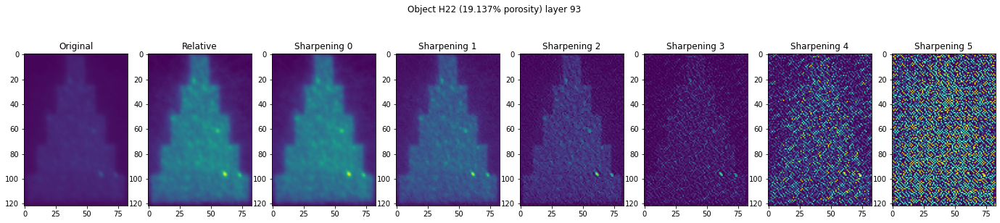

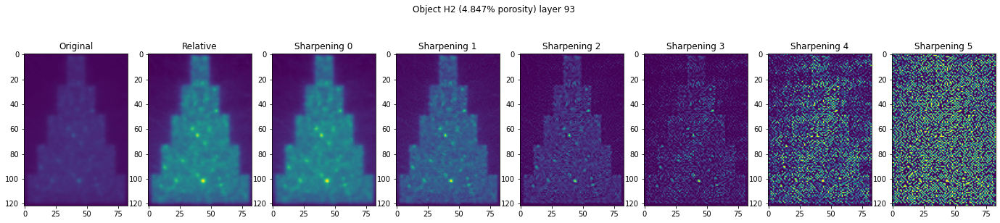

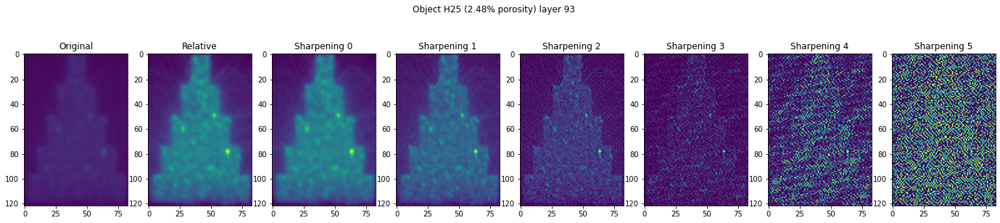

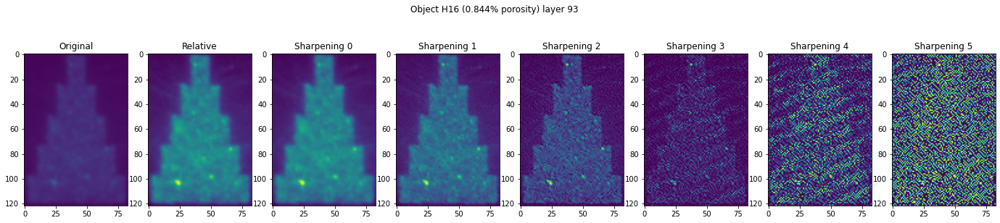

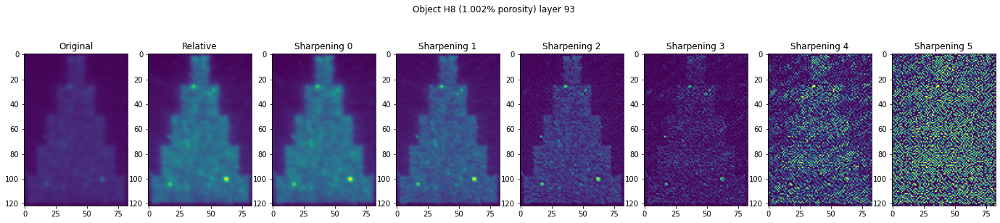

...

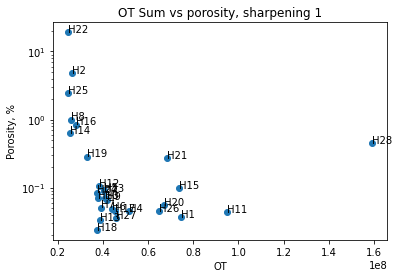

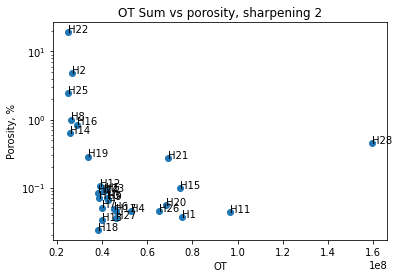

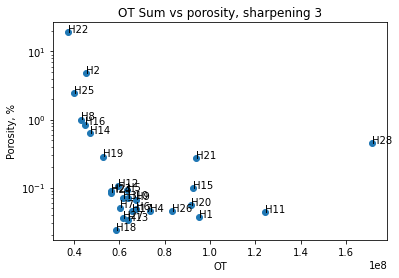

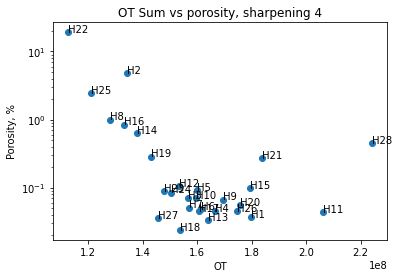

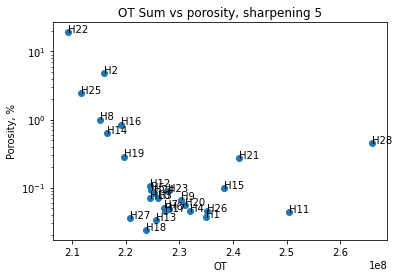

<Figure size 432x288 with 0 Axes>

In [85]:
image = integrals[93] // 2
sharpeningRange = range(1, 6)
kernels = [
    np.array([[0, -i, 0],
              [-i, i*5, -i],
              [0, -i, 0]])
    for i in sharpeningRange]
kernel = kernels[0]
sharp_images = [image]
for i in range(0, 5):
    img = sharp_images[i]
    # for i in range(0, 5):
    img = cv2.filter2D(src=img, ddepth=-1, kernel=kernel)
    sharp_images.append(img)

# Let's look at individual objects
imageNo = 93
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    noOfImages = len(sharp_images)
    plots = noOfImages + 2
    fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))
    fig.suptitle("Object " + object.Object + " (" +
                 str(object.Porosity) + "% porosity) layer " + str(imageNo))
    axs[0].set_title("Original")
    axs[1].set_title("Relative")
    axs[0].imshow(integrals[imageNo, object.ystart:object.yend,
                            object.xstart:object.xend], vmin=0, vmax=65535)
    axs[1].imshow(integrals[imageNo, object.ystart:object.yend,
                            object.xstart:object.xend])
    for index, img in enumerate(sharp_images):
        o = index+2
        axs[o].imshow(img[object.ystart:object.yend,
                          object.xstart:object.xend])
        axs[o].set_title("Sharpening " + str(index))

# Scatter plots
plt.figure()
y = objectinfo.Porosity
plt.title("OT Sum vs porosity original")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

for index, image in enumerate(sharp_images):
    plt.title("OT Sum vs porosity, sharpening " + str(index))
    x = [np.sum(image[object.ystart:object.yend, object.xstart:object.xend])
         for index, object in objectinfo.iterrows()]
    plt.scatter(x, y)
    for index, row in objectinfo.iterrows():
        plt.annotate(text=row.Object, xy=(x[index], y[index]))
    plt.yscale('log')
    plt.ylabel('Porosity, %')
    plt.xlabel('OT')
    plt.figure()
